In [2]:
import matplotlib.pyplot as plt
import xarray as xr
import rioxarray as rxr
import geopandas as gpd
import pandas as pd
import numpy as np
import rasterio as rio
import math
import time
from datetime import datetime, timedelta
from pathlib import Path
from rasterio.plot import show
from io import StringIO
from netCDF4 import date2num


## Get Necessary Variables for Calculation

In [3]:
modis_albedo_data_dir = "/global/cfs/cdirs/m3779/felix/modis/reprojected_colorado_modis_data_lat_lon"
aod_data_dir = "/global/cfs/cdirs/m3779/felix/modis/reprojected_aod_data"
aod_lookup_table_file = "/global/homes/f/feyu39/MODIS/CERES_SYN1deg-Day_Terra-Aqua-MODIS_Ed4.1_Subset_20000301-20231130.nc"
diffuse_skylight_ratio_lookup = "sw_lut.csv"
ex_format_tif = "/global/cfs/cdirs/m3779/felix/modis/reprojected_colorado_modis_data_lat_lon/MCD43A3.A2022314.h09v05.061.2022323034956_clipped_reprojected"

In [4]:
AOD_OFFSET = 0.001
ALBEDO_OFFSET = 0.001
SAIL_LOCATION = (39, -106)

In [5]:
def get_albedo_values(dir_in, black_sky_bool):
    # Output: Dictionary with key as the date and value as the albedo value
    albedo_arr = {}
    dir_path = Path(dir_in)
    
    all_files = list(dir_path.iterdir())
    sorted_files = sorted(all_files, key=lambda x: x.name)

    for file in sorted_files:
        if file.is_file():
            # Map the black/white sky albedo val to the date
            date = str(file).split(".")[1][1:]
            raster = rxr.open_rasterio(file)
            albedo_data = raster.sel(band=1) if black_sky_bool else raster.sel(band=2)
            albedo_arr[date] = albedo_data
                
    return albedo_arr

In [6]:
black_sky_albedo_arr =  get_albedo_values(modis_albedo_data_dir, True) # Clear sky
white_sky_albedo_arr =  get_albedo_values(modis_albedo_data_dir, False) # Cloudy sky


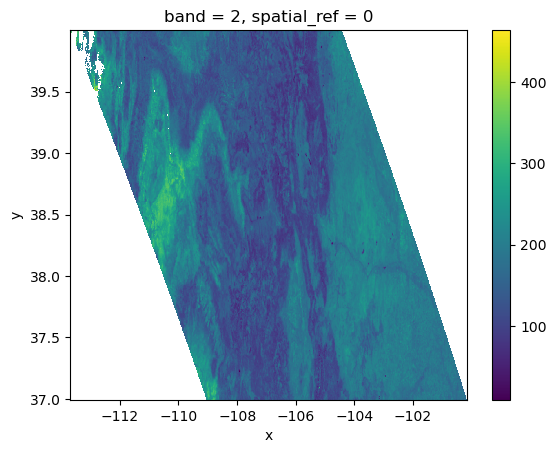

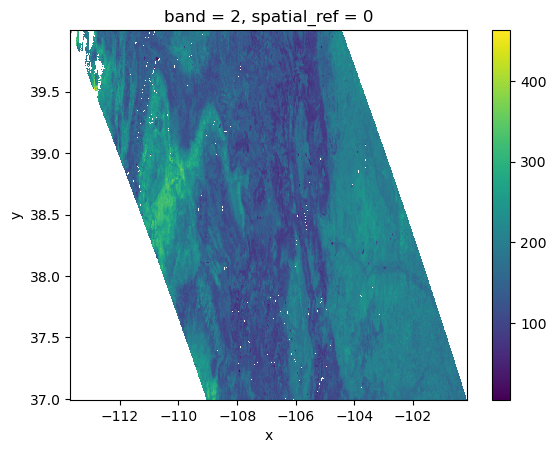

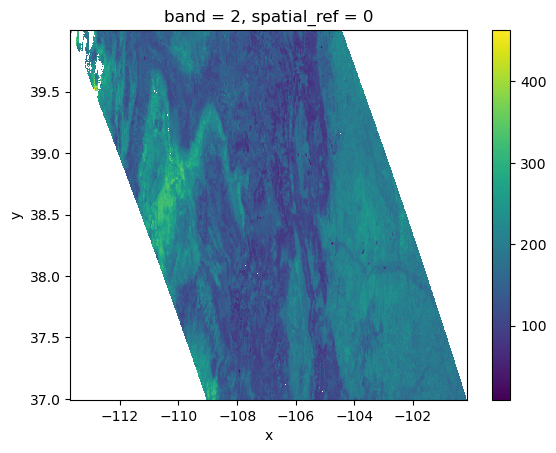

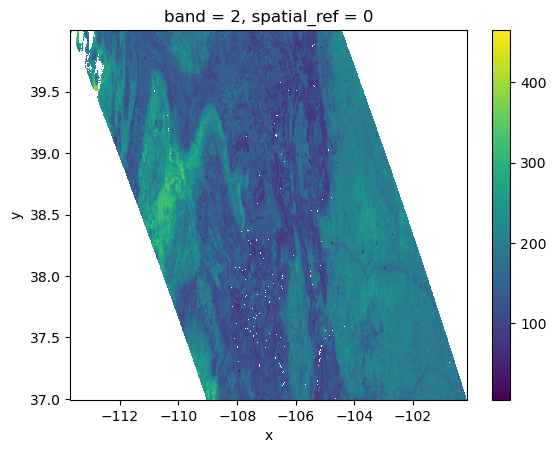

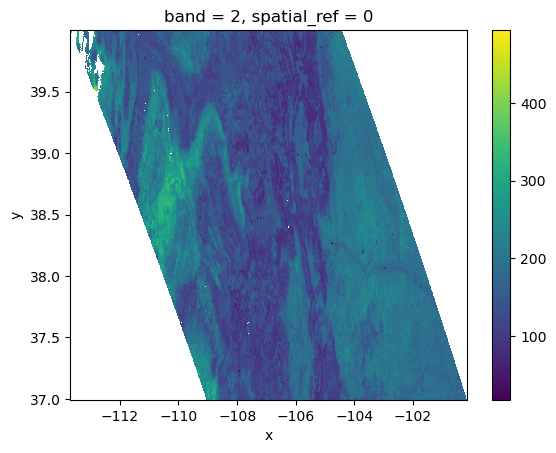

...

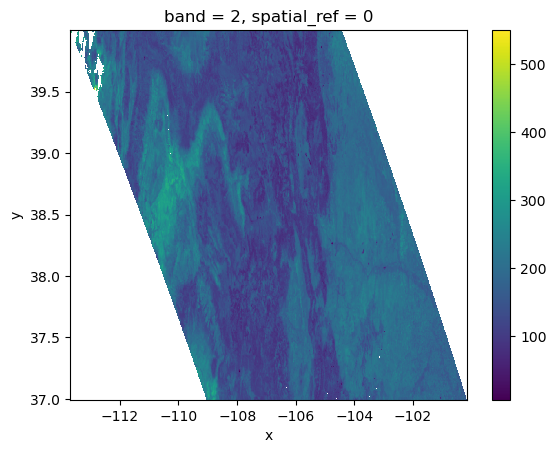

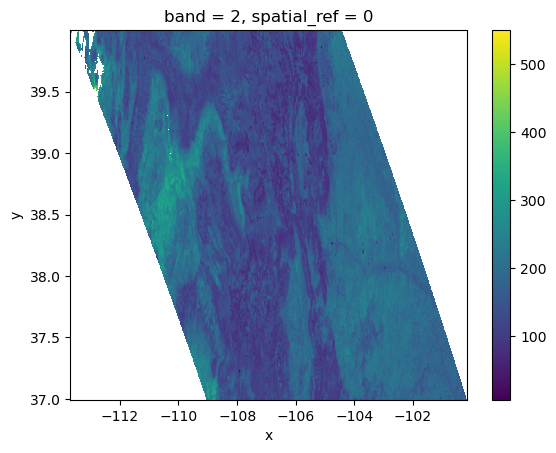

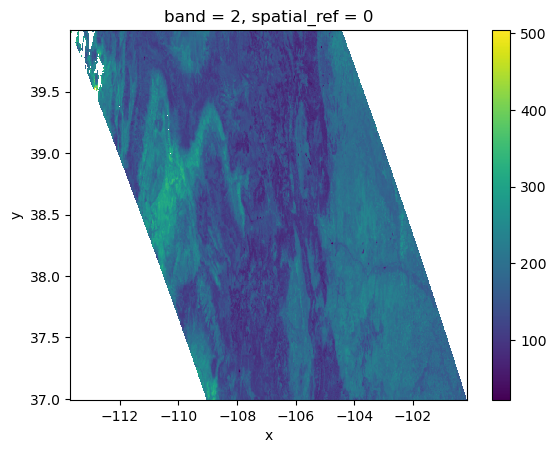

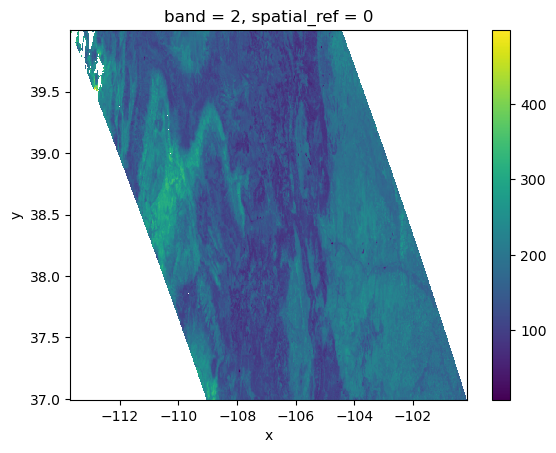

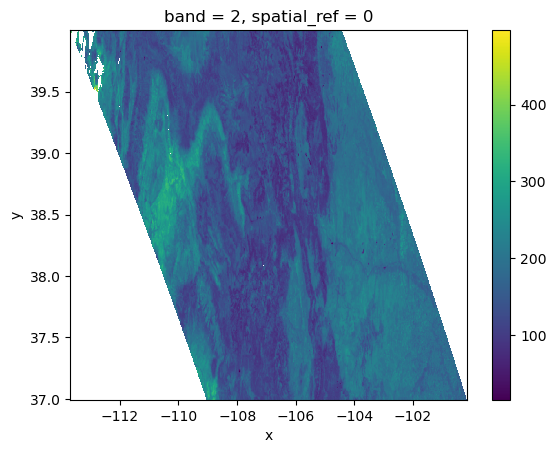

KeyboardInterrupt: 

In [22]:
for date, albedo_val in white_sky_albedo_arr.items():
    albedo_val.plot()
    plt.show()

In [7]:
def get_aod_values(dir_in):
    # Output: Dictionary with key as the date and value as the albedo value
    aod_arr = {}
    dir_path = Path(dir_in)
    
    all_files = list(dir_path.iterdir())
    sorted_files = sorted(all_files, key=lambda x: x.name)

    for file in sorted_files:
        if file.is_file():
            # Map the black/white sky albedo val to the date
            date = str(file).split(".")[1][1:]
            raster = rxr.open_rasterio(file)
            aod_data = raster.sel(band=1)
            aod_arr[date] = aod_data

    return aod_arr

In [30]:
aod_arr = get_aod_values(aod_data_dir)
print(aod_arr)

{'2021244': <xarray.DataArray (y: 16, x: 66)> Size: 4kB
[1056 values with dtype=float32]
Coordinates:
    band         int64 8B 1
  * x            (x) float64 528B -107.2 -107.2 -107.2 ... -106.7 -106.7 -106.7
  * y            (y) float64 128B 39.03 39.03 39.02 39.01 ... 38.93 38.92 38.92
    spatial_ref  int64 8B 0
Attributes:
    AREA_OR_POINT:  Area
    _FillValue:     nan
    scale_factor:   1.0
    add_offset:     0.0, '2021245': <xarray.DataArray (y: 16, x: 66)> Size: 4kB
[1056 values with dtype=float32]
Coordinates:
    band         int64 8B 1
  * x            (x) float64 528B -107.2 -107.2 -107.2 ... -106.7 -106.7 -106.7
  * y            (y) float64 128B 39.03 39.03 39.02 39.01 ... 38.93 38.92 38.92
    spatial_ref  int64 8B 0
Attributes:
    AREA_OR_POINT:  Area
    _FillValue:     nan
    scale_factor:   1.0
    add_offset:     0.0, '2021246': <xarray.DataArray (y: 16, x: 66)> Size: 4kB
[1056 values with dtype=float32]
Coordinates:
    band         int64 8B 1
  * x           

## Get AOD Values from CERES Time Series Data

In [18]:
def get_aod_static_data(dir_in, date, location=SAIL_LOCATION):
    start_date = datetime(2000, 3, 1)
    
    with xr.open_dataset(dir_in) as aod_ds:
        date_in = datetime.strptime(date, "%Y%j")
        return aod_ds["ini_aod55_daily"].sel(lat=location[0], lon=location[1], time=date_in, method='nearest').values

## Calculate diffuse skylight ratio lookup table

In [11]:
# Index lookup table by solar zenith angle (row) and aerosol optical depth (column)
lookup_table = pd.read_csv(diffuse_skylight_ratio_lookup)

# Ensure that the types match
print("Type of index values:", type(lookup_table.index[0]))
print("Type of column values:", type(lookup_table.columns[0]))

Type of index values: <class 'int'>
Type of column values: <class 'str'>


## Calculate Solar Zenith Angle

In [12]:
def get_solar_zenith(latitudes, date):
    # Convert latitudes to an np array for vectorized calculations
    latitudes = np.array(latitudes)
    # Date is in YYYYDDD
    doy = int(date[:4])
    ndoy = int(date[4:])
    
    # Calculate declination angle
    decl = np.cos(np.radians((doy + 10) * (360 / ndoy))) * -23.45
    
    # Calculate solar altitude and solar zenith angle
    solar_altitude = 90 - latitudes + decl
    solar_zenith = 90 - solar_altitude
    
    return solar_zenith
    

In [13]:
def convert_last_digit_of_float(value, decimals=2):
    """
    Rounds the decimal portion of the float to be an even decimal (rounded down)
    Used to index the lookup table for the diffuse skylight ratiio
    
    Parameters:
        value (string): The string of the float value
        decimals (int): The number of decimal places to round to.
        
    Returns:
        float: The rounded float value with an even last digit.
    """     
    float_value = round(float(value), 2)
    
    if float_value == 0:
        return "0"
    
    # Multiply the value by 100, take the floor to round down
    floored_value = math.floor(float_value * 100)
    
    # Extract the last digit
    last_digit = floored_value % 10
    
    # Check if the last digit is even
    if last_digit % 2 != 0:
        # If the last digit is odd, subtract 1 to make it even
        floored_value -= 1
    
    # Divide by 100 to get the final result with two decimal places
    even_value = floored_value / 100.0
    
    if even_value == 0:
        return "0"
    
    # Convert the result back to a string in the format 0.nn
    return str(even_value)


## Calculate Blue Sky Albedo

In [14]:
# This function is using the AOD values from MCD Array
def calculate_blue_sky_albedo_OLD(black_sky_albedo_arr_in, white_sky_albedo_arr_in, aod_arr_in, lookup_table_in, black_sky_tif_in):
    blue_sky_albedo_arr = {}
    
    with rio.open(black_sky_tif_in) as src:
        transform = src.transform

    for date, bsa_arr in black_sky_albedo_arr_in.items():
        if date in aod_arr_in:
            aod_2d_arr = aod_arr_in[date]

            # Create the data array full of nan values
            blsa_data = np.full_like(bsa_arr.values, np.nan)

            # Get all coordinates and values at once to avoid looping
            bsa_values = bsa_arr.values
            y_coords, x_coords = np.meshgrid(bsa_arr['y'].values, bsa_arr['x'].values, indexing='ij')

            # Get corresponding AOD values interpolated to the nearest y and x coords of the black sky albedo arr
            # TODO: This is an interpolation and not exact. Ensure that it is okay
            aod_values = aod_2d_arr.interp(y=bsa_arr['y'], x=bsa_arr['x'], method="nearest").values
            # Get white sky albedo values
            wsa_values = white_sky_albedo_arr_in[date].values

            # Mask valid values
            valid_mask = ~np.isnan(bsa_values) & ~np.isnan(aod_values) & ~np.isnan(wsa_values)
            aod_non_nan_mask = ~np.isnan(aod_values)
            
            # Precompute solar zenith angles
            lon, lat = rio.transform.xy(transform, y_coords, x_coords, offset='center')
            solar_zenith_angles = get_solar_zenith(lat, date)
            # Zenith angle for every latitude 
            rounded_solar_zenith_angles = np.round(solar_zenith_angles).astype(int)

            # Vectorized aod values rounded
            aod_vals_rounded = np.round(aod_values * AOD_OFFSET, 2).astype(str)
            
            # Vectorize converting column labels to correct format to index the csv lookup table
            # Apply convert_last_digit_of_float to non-NaN values only
            vectorized_convert = np.vectorize(convert_last_digit_of_float, otypes=[str])
            aod_vals_rounded[aod_non_nan_mask] = vectorized_convert(aod_vals_rounded[aod_non_nan_mask])
            # print(aod_vals_rounded[aod_non_nan_mask])
            # Initialize an array to store diffuse skylight ratios
            diffuse_skylight_ratios = np.full_like(bsa_values, np.nan)
            
            # Compute diffuse skylight ratios for all valid points
            for angle in np.unique(rounded_solar_zenith_angles):
                angle_mask = (rounded_solar_zenith_angles == angle) & valid_mask
                if np.any(angle_mask):
                    valid_aod_vals = aod_vals_rounded[angle_mask]
                    for unique_val in np.unique(valid_aod_vals):
                        lookup_result = lookup_table_in.loc[angle, unique_val]
                        diffuse_skylight_ratios[angle_mask & (aod_vals_rounded == unique_val)] = lookup_result

            # Compute blue sky albedo for valid points
            blsa_data[valid_mask] = (
                (1 - diffuse_skylight_ratios[valid_mask]) * (bsa_values[valid_mask] * ALBEDO_OFFSET) +
                diffuse_skylight_ratios[valid_mask] * (wsa_values[valid_mask] * ALBEDO_OFFSET)
            )
            
            blue_sky_albedo_arr[date] = xr.DataArray(
                blsa_data,
                coords=bsa_arr.coords,
                dims=bsa_arr.dims,
                attrs=bsa_arr.attrs
            )

    return blue_sky_albedo_arr

In [16]:
def calculate_blue_sky_albedo(black_sky_albedo_arr_in, white_sky_albedo_arr_in, lookup_table_in, black_sky_tif_in):
    blue_sky_albedo_arr = {}
    
    with rio.open(black_sky_tif_in) as src:
        transform = src.transform

    for date, bsa_arr in black_sky_albedo_arr_in.items():
        
        # Calculate AOD value from time series lookup table
        aod_value = get_aod_static_data(aod_lookup_table_file, date)

        # Create the data array full of nan values
        blsa_data = np.full_like(bsa_arr.values, np.nan)

        # Get all coordinates and values at once to avoid looping
        bsa_values = bsa_arr.values
        y_coords, x_coords = np.meshgrid(bsa_arr['y'].values, bsa_arr['x'].values, indexing='ij')

        # Get white sky albedo values
        wsa_values = white_sky_albedo_arr_in[date].values

        # Mask valid values
        valid_mask = ~np.isnan(bsa_values) & ~np.isnan(wsa_values)

        # Precompute solar zenith angles
        lon, lat = rio.transform.xy(transform, y_coords, x_coords, offset='center')
        solar_zenith_angles = get_solar_zenith(lat, date)
        
        # Zenith angle for every latitude 
        rounded_solar_zenith_angles = np.round(solar_zenith_angles).astype(int)

        # Convert aod values labels to the correct format to index the csv lookup table
        converted_aod_value = convert_last_digit_of_float(aod_value)
        
        # Initialize an array to store diffuse skylight ratios
        diffuse_skylight_ratios = np.full_like(bsa_values, np.nan)
        
        # Compute diffuse skylight ratios for all NaN points
        valid_angles = rounded_solar_zenith_angles[valid_mask]
        lookup_results = lookup_table_in.loc[valid_angles, converted_aod_value].values

        # Assign lookup results to the diffuse skylight ratios array
        diffuse_skylight_ratios[valid_mask] = lookup_results
        
        # Compute blue sky albedo for valid points
        blsa_data[valid_mask] = (
            (1 - diffuse_skylight_ratios[valid_mask]) * (bsa_values[valid_mask] * ALBEDO_OFFSET) +
            diffuse_skylight_ratios[valid_mask] * (wsa_values[valid_mask] * ALBEDO_OFFSET)
        )

        blue_sky_albedo_arr[date] = xr.DataArray(
            blsa_data,
            coords=bsa_arr.coords,
            dims=bsa_arr.dims,
            attrs=bsa_arr.attrs
        )

    return blue_sky_albedo_arr

In [ ]:
blue_sky_albedo = calculate_blue_sky_albedo(black_sky_albedo_arr, white_sky_albedo_arr, lookup_table, ex_format_tif)

In [ ]:
print(len(blue_sky_albedo))

## Write Blue Sky Albedo Data to Raster

In [36]:
def write_to_raster(blue_sky_val, format_tif, output_path_tif):
    # Grab existing metadata and crs to format blue sky albedo exactly the same as black sky albedo
    with rio.open(format_tif) as src:
        metadata = src.profile
        crs = src.crs
        transform = src.transform
        
    rioxarray_data = blue_sky_val.rio.write_crs(crs)
    rioxarray_data = rioxarray_data.rio.write_transform(transform)

    rioxarray_data.rio.to_raster(output_path_tif, **metadata)
    return

In [37]:
name_format = "modis_blue_sky_albedo_"
for date, value in blue_sky_albedo.items():
    new_file_name = f"{date}_{name_format}.tif"
    new_directory = "/global/cfs/cdirs/m3779/felix/modis/blue_sky_albedo/"
    
    Path(new_directory).mkdir(parents=True, exist_ok=True)
    
    output_path = Path(new_directory + new_file_name)
    if not output_path.is_file():
        write_to_raster(value, ex_format_tif, output_path)
        print(f"Wrote to {output_path}")

Wrote to /global/cfs/cdirs/m3779/felix/modis/blue_sky_albedo/2021237_modis_blue_sky_albedo_.tif
Wrote to /global/cfs/cdirs/m3779/felix/modis/blue_sky_albedo/2021238_modis_blue_sky_albedo_.tif
Wrote to /global/cfs/cdirs/m3779/felix/modis/blue_sky_albedo/2021239_modis_blue_sky_albedo_.tif
Wrote to /global/cfs/cdirs/m3779/felix/modis/blue_sky_albedo/2021240_modis_blue_sky_albedo_.tif
Wrote to /global/cfs/cdirs/m3779/felix/modis/blue_sky_albedo/2021241_modis_blue_sky_albedo_.tif
Wrote to /global/cfs/cdirs/m3779/felix/modis/blue_sky_albedo/2021242_modis_blue_sky_albedo_.tif
Wrote to /global/cfs/cdirs/m3779/felix/modis/blue_sky_albedo/2021243_modis_blue_sky_albedo_.tif
Wrote to /global/cfs/cdirs/m3779/felix/modis/blue_sky_albedo/2021244_modis_blue_sky_albedo_.tif
Wrote to /global/cfs/cdirs/m3779/felix/modis/blue_sky_albedo/2021245_modis_blue_sky_albedo_.tif
Wrote to /global/cfs/cdirs/m3779/felix/modis/blue_sky_albedo/2021246_modis_blue_sky_albedo_.tif
Wrote to /global/cfs/cdirs/m3779/felix/m

## Visualize Black Sky and White Sky Albedo

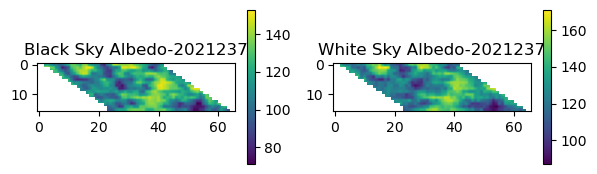

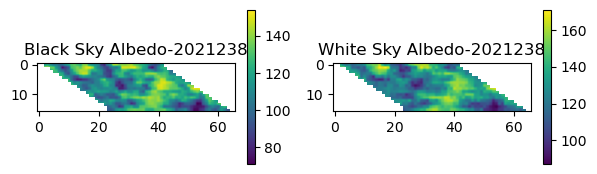

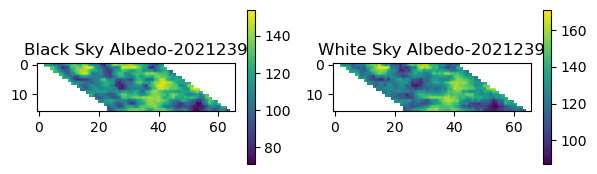

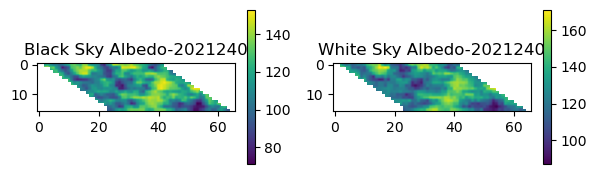

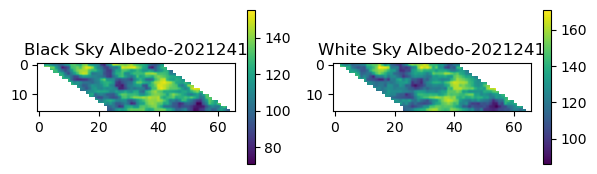

...

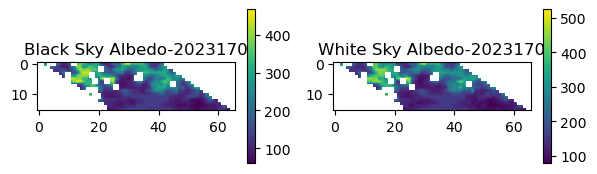

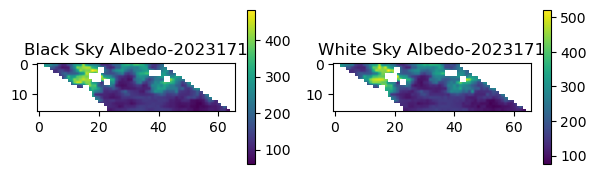

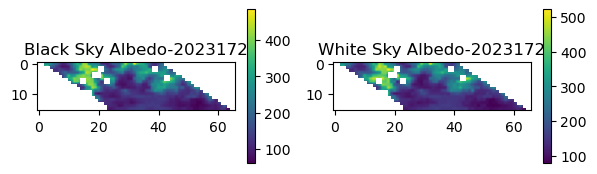

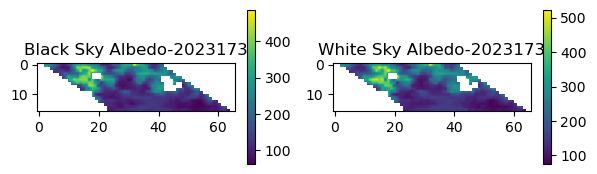

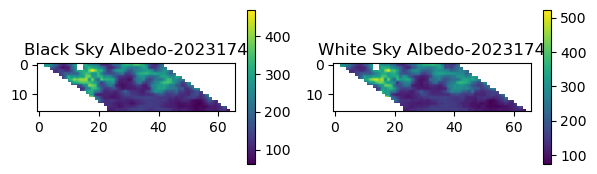

In [76]:
modis_albedo_data_dir_path = Path(modis_albedo_data_dir)

all_files = list(modis_albedo_data_dir_path.iterdir())
sorted_files = sorted(all_files, key=lambda x: x.name)

for file in sorted_files:
    if file.is_file():
        date = str(file).split(".")[1][1:]
        
        # Row, column, width, height
        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(7,2))
        with rio.open(file) as src:
            bsa_img = ax1.imshow(src.read(1))
            ax1.set_title(f"Black Sky Albedo-{date}")
            fig.colorbar(bsa_img, ax=ax1)
            
            wsa_img = ax2.imshow(src.read(2))
            ax2.set_title(f"White Sky Albedo-{date}")
            fig.colorbar(wsa_img, ax=ax2)
            # print(src.meta)
            
            plt.show()
            
            # Delay 1 second to allow for visual check

## Visualize AOD Data

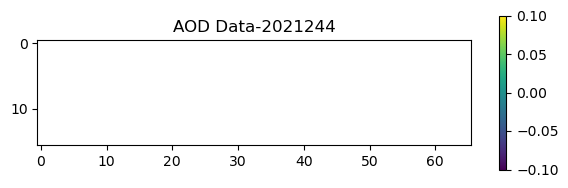

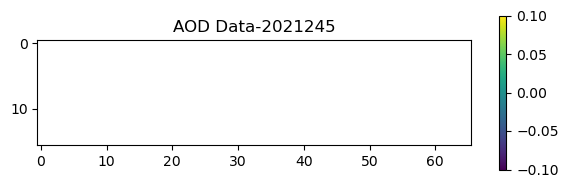

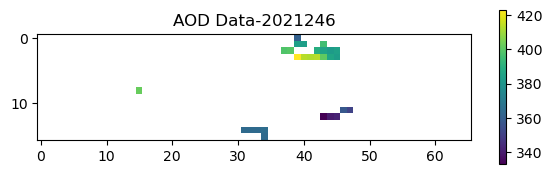

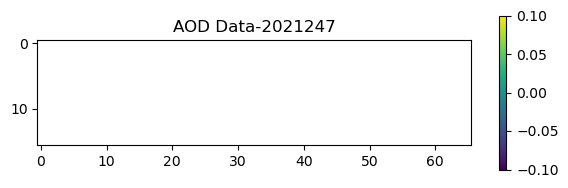

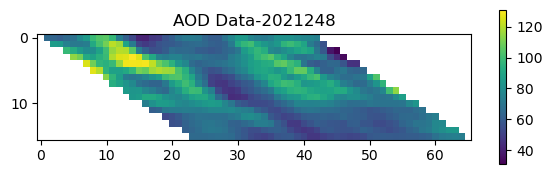

...

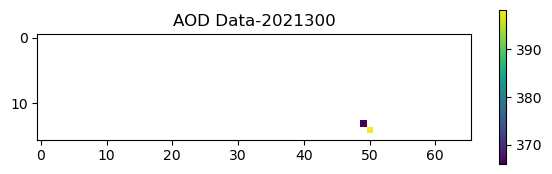

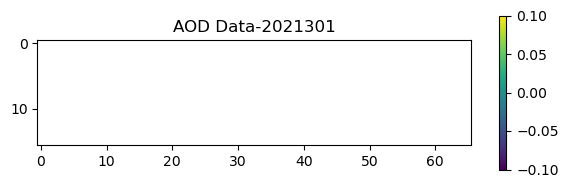

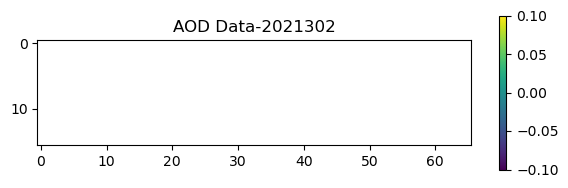

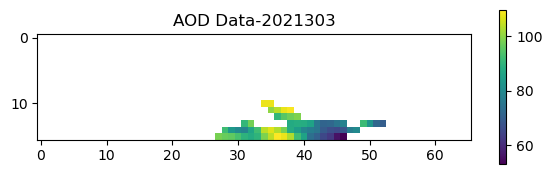

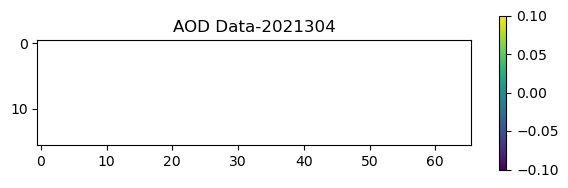

KeyboardInterrupt: 

In [43]:
aod_data_dir_path = Path(aod_data_dir)

all_files = list(aod_data_dir_path.iterdir())
sorted_files = sorted(all_files, key=lambda x: x.name)

for file in sorted_files:
    if file.is_file():
        date = str(file).split(".")[1][1:]
        
        # Row, column, width, height
        fig, (ax1) = plt.subplots(1, 1, figsize=(7,2))
        with rio.open(file) as src:
            aod_img = ax1.imshow(src.read(1))
            ax1.set_title(f"AOD Data-{date}")
            fig.colorbar(aod_img, ax=ax1)
            plt.show()
            
            # Delay 1 second to allow for visual check
            # time.sleep(1)

## Visualize Blue Sky Albedo Data

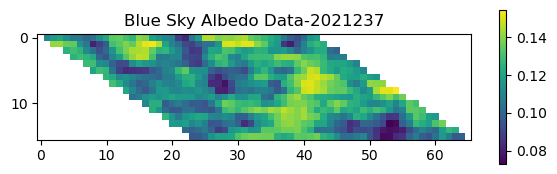

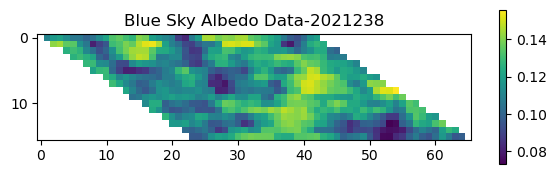

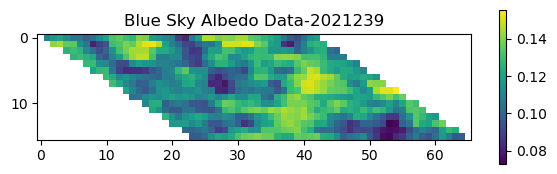

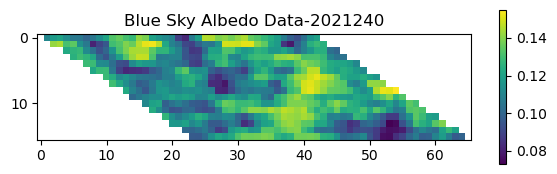

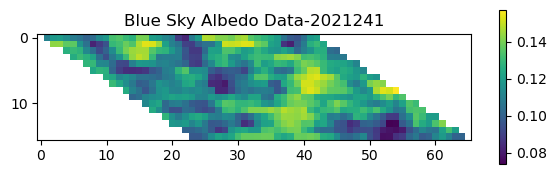

...

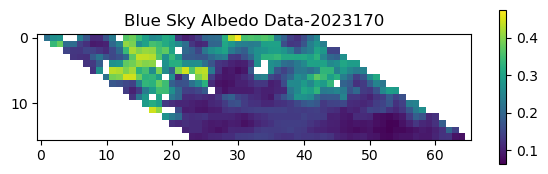

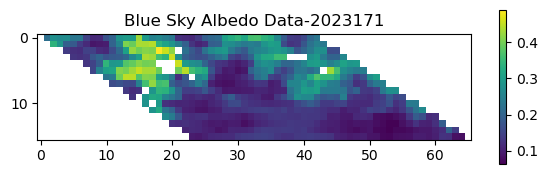

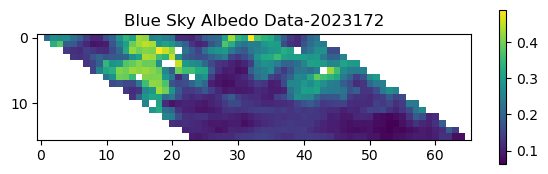

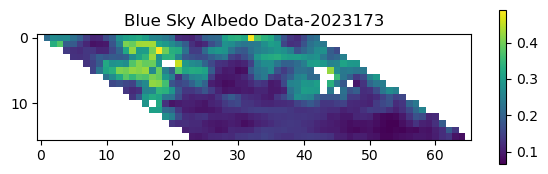

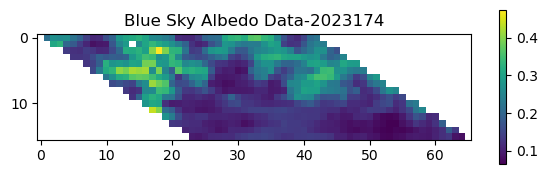

In [87]:
blue_sky_albedo_path = Path("/global/cfs/cdirs/m3779/felix/modis/blue_sky_albedo/")

all_files = list(blue_sky_albedo_path.iterdir())
sorted_files = sorted(all_files, key=lambda x: x.name)

for file in sorted_files:
    if file.is_file():
        date = str(file.stem).split("_")[0]
        
        # Row, column, width, height
        fig, (ax1) = plt.subplots(1, figsize=(7,2))
        with rio.open(file) as src:
            bsa_img = ax1.imshow(src.read(1))
            ax1.set_title(f"Blue Sky Albedo Data-{date}")
            fig.colorbar(bsa_img, ax=ax1)
            plt.show()
            
            # Delay 1 second to allow for visual check
            # time.sleep(1)